<center><h1>Pytorch RetinaNet Training</h1>
<h2>Matthias Bartolo</h2>

</center>


### Package Imports

In [1]:
# !pip install pandas numpy matplotlib seaborn scikit-learn opencv-python albumentations torchmetrics torch-summary
# !pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu124

In [2]:
# !pip install graphviz torchview

In [3]:
import pandas as pd
import numpy as np
import cv2
import random
import os
import time
from matplotlib import pyplot as plt
from tqdm import tqdm
import math
import warnings
import json
from collections import defaultdict
warnings.filterwarnings('ignore')
# from PIL import Image
# import re

# # For models and training
import torch
import torchvision
from torchvision.models.detection.retinanet import RetinaNetClassificationHead
# # https://pytorch.org/vision/0.20/_modules/torchvision/models/detection/retinanet.html
# # https://pytorch.org/vision/main/models.html

# # For data loading
from torchvision.datasets import CocoDetection
from torch.utils.data import DataLoader
from torchvision.transforms import functional as F
import albumentations as A
# from albumentations.pytorch.transforms import ToTensorV2
from albumentations.pytorch import ToTensorV2

# # For evaluation
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
from torchvision.ops import box_iou
import torchvision.ops as ops
from sklearn.preprocessing import label_binarize, LabelEncoder
import seaborn as sns
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from functools import partial

# Seeding everything for reproducibility
seed = 42 #7 # The Perfect Number #12 # The number of Apostles 
torch.manual_seed(seed)  
torch.cuda.manual_seed(seed)  
torch.cuda.manual_seed_all(seed)  # For multi-GPU  
torch.backends.cudnn.deterministic = True  
torch.backends.cudnn.benchmark = False  # Some set this to True
random.seed(seed)
np.random.seed(seed)
torch.use_deterministic_algorithms(True, warn_only=True)# raise error if CUDA >= 10.2
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'
os.environ['CUDNN_DETERMINISTIC'] = '1'
os.environ['PYTHONHASHSEED'] = str(seed)

### Constants

In [4]:
# Directory Inputs
DIR_INPUT = '../datasets/COCO-Dataset'
DIR_TRAIN = f'{DIR_INPUT}/train'
DIR_VALID = f'{DIR_INPUT}/valid'
DIR_TEST = f'{DIR_INPUT}/test'
DIR_IMAGES = 'images'
DIR_ANNOTATIONS = '_annotations.coco.json'
IMG_RESIZE = (800, 800)
SAVE_DIR = f'../runs/RetinaNet/RetinaNet_COCO_teacher1'

# To get the classes from the annotation file
classes_annotation_path = f'{DIR_TRAIN}/{DIR_ANNOTATIONS}'

# Load the annotation file
with open(classes_annotation_path, 'r') as f:
    coco_data = json.load(f)

# Extract class categories
CLASSES = [
    {
        "id": category["id"],
        "name": category["name"],
        "supercategory": category.get("supercategory", "None"),
        "color": (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)),
    }
    for category in coco_data["categories"]
]

# Change id = 0 to Background
CLASSES[0]['name'] = 'Background'

coco_80_91 = [
    "background2",  # 80 (typically not used, might be reserved)
    "toaster",     # 81
    "sink",        # 82
    "refrigerator",# 83
    "book",        # 84
    "clock",       # 85
    "vase",        # 86
    "scissors",    # 87
    "teddy bear",  # 88
    "hair drier",  # 89
    "toothbrush"   # 90
]

# add the other classes from 80 to 90
for i in range(80, 91):
    CLASSES.append({
        "id": i,
        "name": coco_80_91[i-80],
        "supercategory": "None",
        "color": (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)),
    })

NUM_CLASSES = len(CLASSES) # Number of classes in the dataset

# Privileged Information Paths
PRIVILEGED_INFORMATION_DIRS = [

# Special Constructed Features
    "Box_Mask",
]

# Number of input image channels RGB + Extras
NUM_CHANNELS = 3 + len(PRIVILEGED_INFORMATION_DIRS)

# Device for pytorch
device =  torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Creating output directory
os.makedirs(SAVE_DIR, exist_ok=True)
os.makedirs(f'{SAVE_DIR}/weights', exist_ok=True)

# Print the number of channels
print(f"Number of input channels: {NUM_CHANNELS}")

Number of input channels: 4


### Data Loading

In [5]:
class COCODataset(CocoDetection):
    def __init__(self, root, annFile, privileged_information_dirs=PRIVILEGED_INFORMATION_DIRS, transforms=None, img_resize=IMG_RESIZE):
        super().__init__(os.path.join(root, DIR_IMAGES), annFile)
        """
        Args:
            root (string): Root directory where images are downloaded to.
            annFile (string): Path to json annotation file.
            privileged_information_dirs (list): List of directories containing privileged information for each image.
            transforms (callable, optional): A function/transform that takes in a sample and returns a transformed version.
        """
        # Set image directory
        self.image_dir = os.path.join(root, DIR_IMAGES)
        # Setting the privileged information directories
        if privileged_information_dirs is not None:
            self.privileged_dirs = [os.path.join(root, p) for p in privileged_information_dirs] if privileged_information_dirs else None
        else:
            self.privileged_dirs = None

        # Set transforms
        self.transforms = transforms
        self.img_resize = img_resize

    def __len__(self):
        return len(self.ids)
        
    def __getitem__(self, index):
        try:
            # Retrieve the image and target
            img, target = super().__getitem__(index)
            # Storing the original size of the image
            original_size = img.size
            
            # Transform image (resize, convert to tensor, normalize)
            if self.img_resize:
                img = img.resize(self.img_resize)

            img = F.to_tensor(img)
            # Normalize image by dividing by 255 (it is being scaled already from 0-255 to 0-1, through super().__getitem__)
            # img /= 255.0
            
            # Load privileged information if available
            if self.privileged_dirs:
                # Load the images from the privileged directories
                privileged = [cv2.imread(os.path.join(priv_dir, self.coco.loadImgs(self.ids[index])[0]["file_name"]), cv2.IMREAD_UNCHANGED) for priv_dir in self.privileged_dirs]
                # Normalize privileged information
                privileged = [(p / 255.0).astype(np.float32) for p in privileged] # Normalize privileged information
                # Convert to tensor and add channel dimension
                privileged_tensors = [torch.tensor(p).unsqueeze(0) for p in privileged] # Convert to tensor and add channel dimension
                # Apply resize to the privileged information
                if self.img_resize:
                    privileged_tensors = [F.to_tensor(cv2.resize(p, self.img_resize)) for p in privileged]

                # Concatenate image and privileged information
                img = torch.cat([img] + privileged_tensors, dim=0)
            
            # Error Chacking that the whole tensor is between 0 and 1
            if torch.any(img < 0) or torch.any(img > 1):
                raise ValueError("Image tensor is not between 0 and 1")

            # Process annotations
            boxes = []
            labels = []
            sizes = []
            for annotation in target:
                # Load bounding box coordinates
                bbox = annotation["bbox"]
                bbox = [bbox[0], bbox[1], bbox[0] + bbox[2], bbox[1] + bbox[3]]  # Convert to (x_min, y_min, x_max, y_max (Pascol VOC format))
                # Resize bounding box coordinates
                if self.img_resize:
                    bbox = [bbox[0] / original_size[0] * self.img_resize[0], bbox[1] / original_size[1] * self.img_resize[1], bbox[2] / original_size[0] * self.img_resize[0], bbox[3] / original_size[1] * self.img_resize[1]]

                # Append bounding box and label
                boxes.append(bbox)
                if annotation["category_id"] != 0: # Skip background class
                    labels.append(annotation["category_id"])
                    # labels.append(1)

                sizes.append(original_size)
            
            # Convert to tensors
            target_dict = {
                "boxes": torch.FloatTensor(boxes),
                "labels": torch.LongTensor(labels),
                "image_id": torch.tensor([index]),
                "size": torch.tensor(sizes)
            }

            # Ensure that targer boxes are of shape (N, 4)
            if target_dict["boxes"].shape[0] == 0:
                target_dict["boxes"] = torch.zeros((0, 4))
            elif len(target_dict["boxes"].shape) == 1:
                target_dict["boxes"] = target_dict["boxes"].unsqueeze(0)
            
            # Apply transforms (Data Augmentation)
            if self.transforms:
                sample = {"image": img, "bboxes": target_dict["boxes"], "labels": target_dict["labels"]}
                sample = self.transforms(sample)
                img, target_dict["boxes"], target_dict["labels"] = sample["image"], sample["bboxes"], sample["labels"]
            
            # Return image and target dictionary
            return img, target_dict
        
        except Exception as e:
            print(f"Error loading index {index}: {str(e)}")
            raise e

### Data Augmentation

In [6]:
# For Data Augmentation (Not being used, to be done through Roboflow, since we are utilising multiple privileged information channels)
# Define train and validation transformations
def get_train_transform():
    return A.Compose([
        A.HorizontalFlip(p=0.5),  # Flip images horizontally with a probability of 0.5
        A.VerticalFlip(p=0.5),    # Optionally, flip images vertically (remove if not needed)
        ToTensorV2(p=1.0)         # Ensure the image is converted to a tensor
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

def get_valid_transform():
    return A.Compose([
        ToTensorV2(p=1.0)         # Ensure the image is converted to a tensor
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

# Example usage with images that have more than 3 channels
def transform_image(image, transform):
    # Example: If your image has more than 3 channels, ensure to specify the number of channels
    augmented = transform(image=image)
    return augmented['image']  # Return the augmented image (tensor)

### Image Mean and Standard Deviation

In [ ]:
# Calculating the image mean and standard deviation
"""
From Pytorch documentation:
    - mean (sequence) – Sequence of means for each channel.
    - std (sequence) – Sequence of standard deviations for each channel.
    https://pytorch.org/vision/0.9/_modules/torchvision/models/detection/faster_rcnn.html

    Varies based on the dataset used. For COCO dataset, the mean and standard deviation are:
        - mean = [0.485, 0.456, 0.406]
        - std = [0.229, 0.224, 0.225]

    IMPORTANT: CHANGE THESE FOR FINAL DATASET
"""
img_means = [
    0.338, 0.320, 0.292, 0.077
]

img_stds = [
    0.314, 0.304, 0.302, 0.126
]

ALL_PRIVILEGED_INFORMATION_DIRS = [
    "Box_Mask",
]

# Retrieve the correct indexes based on which channels are being used
def get_channel_indexes(privileged_information_dirs):
    indexes = []
    for priv_dir in privileged_information_dirs:
        index = ALL_PRIVILEGED_INFORMATION_DIRS.index(priv_dir)
        indexes.append(index)
    # Add 3 for all the indexes since the first 3 channels are RGB
    indexes = [i + 3 for i in indexes]
    return indexes

# Get the indexes of the privileged information channels
privileged_indexes = get_channel_indexes(PRIVILEGED_INFORMATION_DIRS)

# Add the RGB channels to the privileged indexes
privileged_indexes = [0, 1, 2] + privileged_indexes

channel_means = [img_means[i] for i in privileged_indexes]
channel_stds = [img_stds[i] for i in privileged_indexes]

### Model Initialisation and Modification
<!-- #### Freezing all the layers except the input layer and the output layer -->

In [8]:
# Load the RetinaNet model with pretrained weights
weights = torchvision.models.detection.RetinaNet_ResNet50_FPN_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.retinanet_resnet50_fpn(weights=weights)

model = pre_trained_model.to(device)

# Modify the first convolutional layer for Multi-channel input
model.backbone.body.conv1 = torch.nn.Conv2d(NUM_CHANNELS, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

# Initialize the first convolutional layer's weights
torch.nn.init.kaiming_normal_(model.backbone.body.conv1.weight, mode='fan_out', nonlinearity='relu')

# Dynamically set image mean and std based on the number of channels (using your dataset's values)
model.transform.image_mean = channel_means
model.transform.image_std = channel_stds
model.transform.to(device)

# Get the number of input features for the classification head
in_features = model.head.classification_head.cls_logits.in_channels
num_anchors = model.head.classification_head.num_anchors

# Modify classification head to match the number of classes for your task
# RetinaNetClassificationHead is redefined to include the correct number of classes
model.head.classification_head = RetinaNetClassificationHead(
    in_channels=in_features,
    num_classes=NUM_CLASSES,
    num_anchors=num_anchors,
    norm_layer=partial(torch.nn.GroupNorm, 32)
)

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)

# Verify the model structure
print(model)

RetinaNet(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(4, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=0.0)


### Model Summary

In [9]:
from torchsummary import summary
# Summary of the model
_ = summary(model, verbose=2)# verbose=1 (Default)

Layer (type:depth-idx)                             Param #
├─BackboneWithFPN: 1-1                             --
|    └─body.conv1.weight
|    └─body.layer1.0.conv1.weight
|    └─body.layer1.0.conv2.weight
|    └─body.layer1.0.conv3.weight
|    └─body.layer1.0.downsample.0.weight
|    └─body.layer1.1.conv1.weight
|    └─body.layer1.1.conv2.weight
|    └─body.layer1.1.conv3.weight
|    └─body.layer1.2.conv1.weight
|    └─body.layer1.2.conv2.weight
|    └─body.layer1.2.conv3.weight
|    └─body.layer2.0.conv1.weight
|    └─body.layer2.0.conv2.weight
|    └─body.layer2.0.conv3.weight
|    └─body.layer2.0.downsample.0.weight
|    └─body.layer2.1.conv1.weight
|    └─body.layer2.1.conv2.weight
|    └─body.layer2.1.conv3.weight
|    └─body.layer2.2.conv1.weight
|    └─body.layer2.2.conv2.weight
|    └─body.layer2.2.conv3.weight
|    └─body.layer2.3.conv1.weight
|    └─body.layer2.3.conv2.weight
|    └─body.layer2.3.conv3.weight
|    └─body.layer3.0.conv1.weight
|    └─body.layer3.0.conv2.weigh

In [10]:
# Drawing the  Model
# from torchview import draw_graph
# model_graph = draw_graph(model.backbone, torch.zeros(1, NUM_CHANNELS, 224, 224).to(device), hide_module_functions=False, save_graph=True, filename='backbone_architecture', directory=SAVE_DIR, graph_name='backbone_architecture')
# model_graph = draw_graph(model, torch.zeros(1, NUM_CHANNELS, 224, 224).to(device), hide_module_functions=False, save_graph=True, filename='full_architecture', directory=SAVE_DIR, graph_name='full_architecture')

### Dataloader Initialisation

In [11]:
# Functions to be used for training and validation and for DataLoader
class Averager:
    def __init__(self):
        self.current_total = 0.0
        self.iterations = 0.0

    def send(self, value):
        self.current_total += value
        self.iterations += 1

    @property
    def value(self):
        if self.iterations == 0:
            return 0
        else:
            return 1.0 * self.current_total / self.iterations

    def reset(self):
        self.current_total = 0.0
        self.iterations = 0.0

def collate_fn(batch):
    return tuple(zip(*batch))

"""
Creating the Datasets and DataLoaders
"""
annotation_dir_train = os.path.join(DIR_TRAIN, DIR_ANNOTATIONS)
annotation_dir_valid = os.path.join(DIR_VALID, DIR_ANNOTATIONS)
annotation_dir_test = os.path.join(DIR_TEST, DIR_ANNOTATIONS)

train_dataset = COCODataset(root=DIR_TRAIN, annFile=annotation_dir_train)#, get_train_transform())
valid_dataset = COCODataset(root=DIR_VALID, annFile=annotation_dir_valid)#, get_valid_transform())
test_dataset = COCODataset(root=DIR_TEST, annFile=annotation_dir_test)#, get_valid_transform())

# Define the batch size and number of workers for the DataLoader
batch_size = 4
num_workers = 0

def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

g = torch.Generator()
g.manual_seed(seed)

train_data_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=False, # True
    num_workers=num_workers,
    collate_fn=collate_fn,
    worker_init_fn=seed_worker,
    generator=g
)

valid_data_loader = DataLoader(
    valid_dataset,
    batch_size=batch_size,
    shuffle=False, # True
    num_workers=num_workers,
    collate_fn=collate_fn,
    worker_init_fn=seed_worker,
    generator=g
)

test_data_loader = DataLoader(
    test_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    collate_fn=collate_fn,
    worker_init_fn=seed_worker,
    generator=g
)

loading annotations into memory...
Done (t=8.52s)
creating index...
index created!
loading annotations into memory...
Done (t=3.23s)
creating index...
index created!
loading annotations into memory...
Done (t=1.37s)
creating index...
index created!


In [12]:
# Checking the first batch of the train_data_loader Output
images, targets= train_data_loader.dataset[0]
print(images.shape, targets)

torch.Size([4, 800, 800]) {'boxes': tensor([[321.2500, 178.1250, 501.0250, 357.9000],
        [236.8750, 428.1250, 301.0125, 468.9125],
        [280.0000, 420.6250, 328.4750, 461.2375],
        [426.8750, 420.6250, 442.6625, 431.1000],
        [439.3750, 417.5000, 452.6500, 428.2500],
        [433.7500, 431.2500, 492.4875, 477.8500],
        [323.1250, 426.8750, 350.7625, 455.4875],
        [371.2500, 425.0000, 387.7125, 446.7375],
        [448.1250, 423.1250, 490.8375, 442.3875],
        [342.5000, 420.6250, 374.6375, 449.0250],
        [388.1250, 420.0000, 402.9750, 440.4500]]), 'labels': tensor([64, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]), 'image_id': tensor([0]), 'size': tensor([[1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280],
        [1280, 1280]])}


### Sampling from Training Dataloader Batch

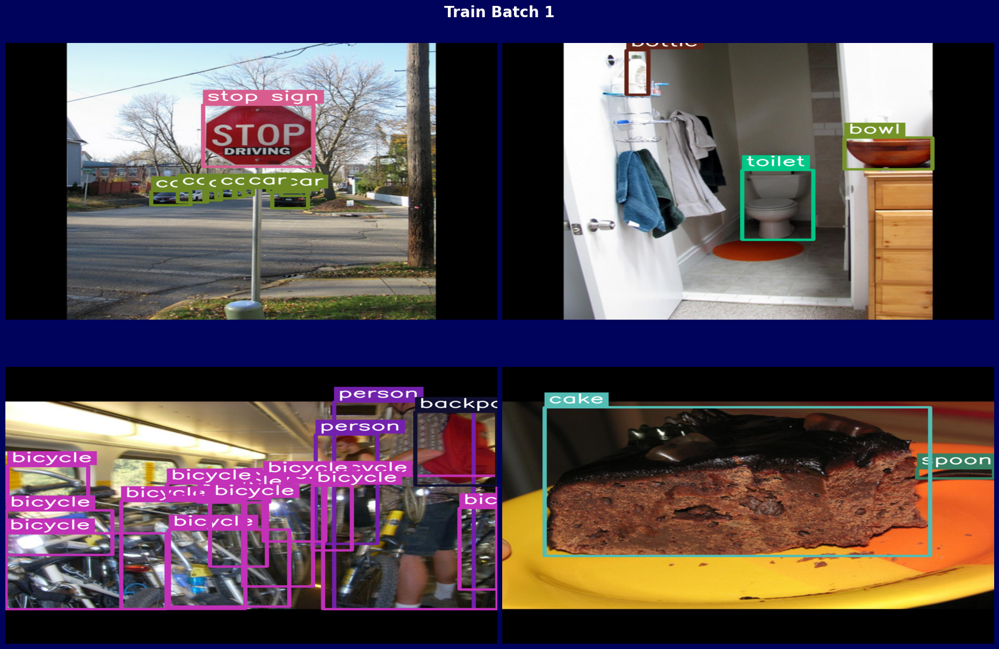

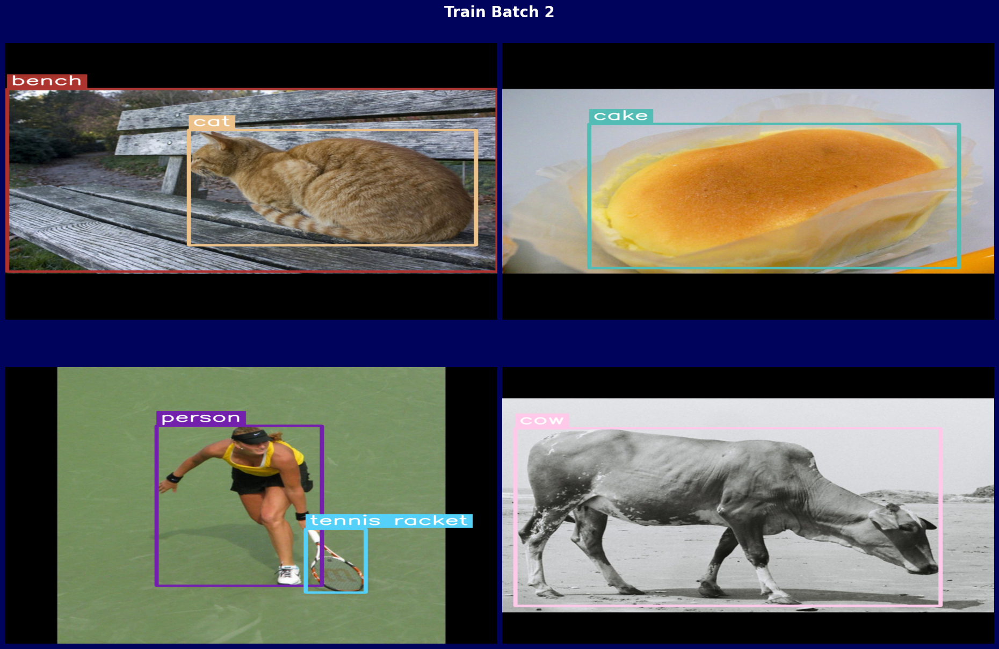

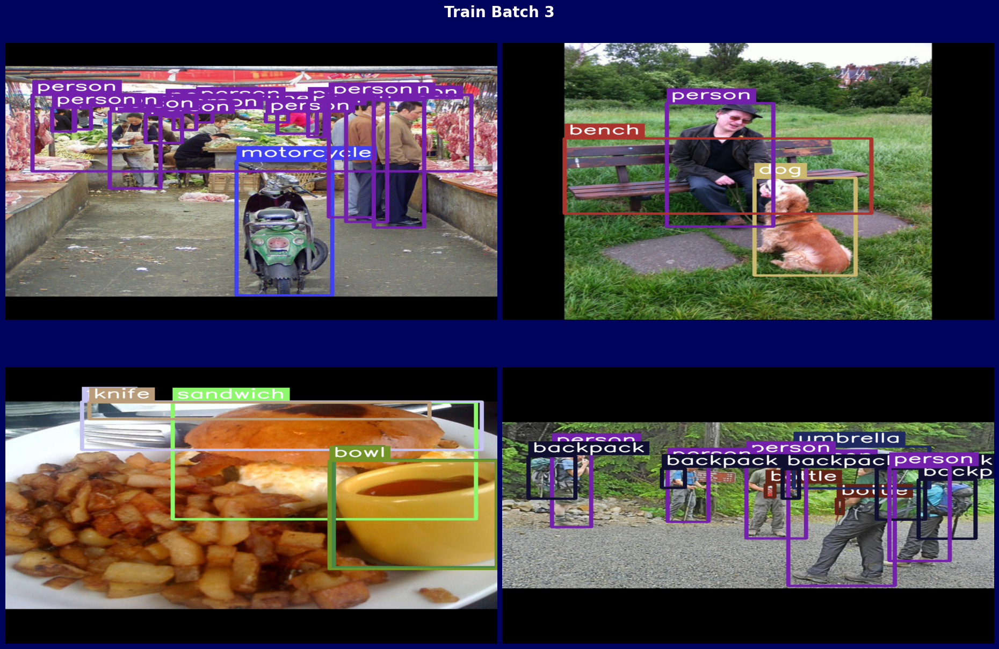

In [13]:
# Plotting the first batch of the train_data_loader
def plot_batches_as_mosaic(train_data_loader, device, num_batches=3, channel_indices=[0, 1, 2], class_definitions=CLASSES, resize_size=(1920, 1080)):
    """
    Plots three figures, one for each batch, showing images as a 2x2 grid with bounding boxes and class labels.
    
    Parameters:
    - train_data_loader: Data loader for training data.
    - device: The device (CPU or GPU) for computation.
    - num_batches: Number of batches to plot.
    - channel_indices: List of channel indices to extract for visualisation (e.g., [0, 1, 2] for RGB).
    - class_definitions: List of class dictionaries containing id, name, and color.
    - resize_size: Size to resize the images for display.
    """
    class_lookup = {cls["id"]: (cls["name"], tuple(cls["color"])) for cls in class_definitions}

    data_iter = iter(train_data_loader)

    for batch_idx in range(num_batches):
        # Load a batch of data
        try:
            # Load a batch of data from the iterator
            images, targets = next(data_iter)
        except StopIteration:
            print("No more batches available in test_data_loader!")
            break

        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        
        # Create a 2x2 grid for visualization
        num_images = len(images)
        grid_size = math.ceil(np.sqrt(num_images))
        fig, axes = plt.subplots(grid_size, grid_size, figsize=(23, 15))

        # Flatten axes for easy iteration
        axes = axes.flatten()

        for img_idx, (image, target) in enumerate(zip(images, targets)):
            # Extract and reshape the image
            sample_image = image.cpu().numpy()

            # Keep only the specified channels
            selected_channels = [sample_image[i] for i in channel_indices]
            
            # Convert channels to uint8 format
            selected_channels = [(channel * 255).astype(np.uint8) for channel in selected_channels]

            # Stack the selected channels to form the image
            sample_image_rgb = np.stack(selected_channels, axis=-1)

            # Convert to uint8
            sample_image_rgb = sample_image_rgb.astype(np.uint8)

            # Get bounding boxes and labels
            boxes = target['boxes'].cpu().numpy()
            labels = target['labels'].cpu().numpy()
            size = target['size'].cpu().numpy()

            # Resize the image and bounding boxes based on the original size
            original_size_x, original_size_y = size[0]
            resize_ratio_x = original_size_x / IMG_RESIZE[0]
            resize_ratio_y = original_size_y / IMG_RESIZE[1]

            # resizing the bounding boxes
            for box in boxes:
                box[0] *= resize_ratio_x
                box[2] *= resize_ratio_x
                box[1] *= resize_ratio_y
                box[3] *= resize_ratio_y

            sample_image_rgb = cv2.resize(sample_image_rgb, size[0])           

            # Draw bounding boxes and labels
            for i, box in enumerate(boxes):
                x_min, y_min, x_max, y_max = map(int, box)

                # Get the class name and color for the current box
                class_id = labels[i]
                class_name, color = class_lookup.get(class_id, (f'Class {class_id}', (255, 255, 255)))

                # Draw the rectangle (bounding box) on the image
                cv2.rectangle(sample_image_rgb, (x_min, y_min), (x_max, y_max), color, 10)

                # Calculate the size of the text
                font_scale = 2
                (text_width, text_height), baseline = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, font_scale, thickness=2)

                # Add some padding around the text for the background
                padding = 10
                text_width += 2 * padding  # Add padding to the left and right
                text_height += 2 * padding  # Add padding to the top and bottom

                # Draw the background rectangle for the class label text
                cv2.rectangle(sample_image_rgb, (x_min, y_min - text_height - 5),
                            (x_min + text_width, y_min - 5), color, -1)

                # Put the class name text (adjusted for padding)
                cv2.putText(sample_image_rgb, class_name, (x_min + padding, y_min - padding - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), thickness=4, lineType=cv2.LINE_AA)

            # Resize the image for display 2k resolution
            sample_image_rgb = cv2.resize(sample_image_rgb, resize_size)

            # Plot the image
            axes[img_idx].imshow(sample_image_rgb)
            axes[img_idx].axis('off')

        # Hide any unused axes
        for ax in axes[num_images:]:
            ax.axis('off')

        fig.suptitle(f"Train Batch {batch_idx + 1}", fontsize=20, weight='bold', color='white', y=0.92)
        plt.tight_layout()
        
        # Adjust space between subplots to make sure all are same size
        plt.subplots_adjust(wspace=0.01, hspace=0.01, top=0.9, bottom=0.1, left=0.1, right=0.9)

        # Make the figure background gray
        fig.patch.set_facecolor('xkcd:dark blue')
        # Save the figure
        plt.savefig(f'{SAVE_DIR}/train_batch_{batch_idx + 1}.png', bbox_inches='tight', pad_inches=0)

        plt.show()

# Example usage
plot_batches_as_mosaic(train_data_loader, device, num_batches=3, channel_indices=[0, 1, 2], class_definitions=CLASSES)


### Model Training

In [14]:
# Extract trainable parameters (those requiring gradients)
params = [p for p in model.parameters() if p.requires_grad]
print("Length of trainable parameters: ", len(params))
# Display all the model parameters which are trainable
names = [name for name, param in model.named_parameters() if param.requires_grad]
print("\nTrainable parameters: ")
for name in names:
    print(name)

# Optimizer: AdamW is effective for object detection tasks
# 'lr' is the learning rate (had previously tried 0.001, 0.0001, 0.00001)
# Also tried SGD with momentum but AdamW was more faster and converged to the same optimal value
optimizer = torch.optim.AdamW(params, lr=0.0001)

# Learning rate scheduler: Reduces the learning rate when validation loss plateaus
# 'patience' determines how many epochs to wait before reducing the learning rate
# 'factor' is the rate of decay (0.5 halves the learning rate)
lr_scheduler = None
# torch.optim.lr_scheduler.ReduceLROnPlateau(
#     optimizer, mode='min', patience=2, factor=0.5, verbose=True
# )

# Early stopping: Stops training after a set number of epochs without improvement
# 'patience' is the number of epochs to wait before stopping
patience = 5

# Number of epochs for training
NUM_EPOCHS = 100

Length of trainable parameters:  83

Trainable parameters: 
backbone.body.conv1.weight
backbone.body.layer2.0.conv1.weight
backbone.body.layer2.0.conv2.weight
backbone.body.layer2.0.conv3.weight
backbone.body.layer2.0.downsample.0.weight
backbone.body.layer2.1.conv1.weight
backbone.body.layer2.1.conv2.weight
backbone.body.layer2.1.conv3.weight
backbone.body.layer2.2.conv1.weight
backbone.body.layer2.2.conv2.weight
backbone.body.layer2.2.conv3.weight
backbone.body.layer2.3.conv1.weight
backbone.body.layer2.3.conv2.weight
backbone.body.layer2.3.conv3.weight
backbone.body.layer3.0.conv1.weight
backbone.body.layer3.0.conv2.weight
backbone.body.layer3.0.conv3.weight
backbone.body.layer3.0.downsample.0.weight
backbone.body.layer3.1.conv1.weight
backbone.body.layer3.1.conv2.weight
backbone.body.layer3.1.conv3.weight
backbone.body.layer3.2.conv1.weight
backbone.body.layer3.2.conv2.weight
backbone.body.layer3.2.conv3.weight
backbone.body.layer3.3.conv1.weight
backbone.body.layer3.3.conv2.weight

In [15]:
# Helper function to plot losses
def plot_training_summary_with_df(loss_df):
    """
    Plots the training and validation loss over epochs, with beautified colors and appearance.
    
    Parameters:
    - loss_df: DataFrame containing columns for 'train_loss' and 'val_loss'.
    """
    # Define custom colors
    train_color = '#1f3a8a'  # Dark Blue
    val_color = '#28a745'    # Green

    # Plotting
    plt.figure(figsize=(12, 6))

    # Plot total train and validation losses
    plt.plot(loss_df.index, loss_df['train_loss'], label='Training Loss', color=train_color, linewidth=2)
    plt.plot(loss_df.index, loss_df['val_loss'], label='Validation Loss', color=val_color, linewidth=2)

    # Customize plot
    plt.xlabel('Epoch', fontsize=12)
    plt.ylabel('Loss', fontsize=12)
    plt.title('Training and Validation Losses', fontsize=16)
    plt.legend(loc='upper right', fontsize=10)
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.savefig(f'{SAVE_DIR}/training_summary.png', bbox_inches='tight', pad_inches=0)

    # Show plot
    plt.show()

# Helper function to plot individual losses
def plot_individual_losses(loss_df):
    """
    Plots individual loss values (like train_loss, validation_loss, etc.) on separate subplots in a dynamic layout.
    The layout has len(columns)//2 columns.
    
    Parameters:
    - loss_df: DataFrame containing columns for various loss values (e.g., 'train_loss', 'val_loss', etc.).
    """
    # Extract all the columns except epoch
    loss_columns = [col for col in loss_df.columns if col != 'epoch']
    num_plots = len(loss_columns)
    
    # Determine the number of columns (half the number of loss columns)
    num_cols = num_plots // 2
    num_rows = 2 if num_plots > num_cols else 1  # 1 or 2 rows depending on the number of columns
    
    # Create subplots with dynamic layout (half the number of loss columns as the number of columns)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 6), sharey=True)
    
    # If only one row, make axes a 1D array for easier indexing
    if num_rows == 1:
        axes = np.array([axes])  # Convert to 2D array for consistent indexing
    
    # Loop through the loss columns and plot each on a separate subplot
    for idx, loss_col in enumerate(loss_columns):
        # If num_rows is 1, axes is 1D, so we access it with just idx
        if num_rows == 1:
            ax = axes[idx]
        else:
            # Otherwise, we access the subplot in the grid as a 2D array
            ax = axes[idx // num_cols, idx % num_cols]
        
        # Plot original loss
        ax.plot(loss_df.index, loss_df[loss_col], color='darkblue', linewidth=2)
        
        # Set labels and title
        ax.set_xlabel('Epoch', fontsize=12)
        ax.set_ylabel('Loss', fontsize=12)
        ax.set_title(f'{loss_col.replace("_", " ").title()} Over Epochs', fontsize=14)
        ax.grid(True, which='both', linestyle='--', linewidth=0.5)
    
    plt.tight_layout()
    plt.savefig(f'{SAVE_DIR}/individual_losses.png', bbox_inches='tight', pad_inches=0)
    plt.show()


# Training and validation loop
def train_and_validate(model, train_data_loader, test_data_loader, optimizer=optimizer, lr_scheduler=lr_scheduler, num_epochs=NUM_EPOCHS, patience=patience, device=device):
    """
    Train and validate the model for a specified number of epochs, with early stopping and learning rate scheduling.
    
    Parameters:
    - model: The object detection model to train.
    - train_data_loader: DataLoader for the training data.
    - test_data_loader: DataLoader for the validation data.
    - optimizer: Optimizer used for training.
    - lr_scheduler: Learning rate scheduler (optional).
    - num_epochs: Number of epochs to train the model.
    - patience: Number of epochs to wait before early stopping.
    - device: Device ('cpu' or 'cuda') for training.
    
    Returns:
    - loss_dict_values: Dictionary with loss values for each epoch.
    - epoch_losses: List of average losses for each epoch.
    - val_epoch_losses: List of average validation losses for each epoch.
    - val_dict_values: Dictionary with validation losses for each epoch.
    - loss_df: DataFrame containing all loss values for better tracking.
    """
    # Initialize tracking variables
    patience_counter = 0
    best_loss = float('inf')
    epoch_losses = []
    val_epoch_losses = []
    loss_dict_values = []
    val_dict_values = []
    time_elapsed_per_epoch = []

    model.to(device)
    
    # Loop over epochs
    for epoch in range(num_epochs):
        model.train()
        loss_values = []  # Collect batch losses for epoch averaging
        avg_loss_dict = {}  # Average the loss dictionary values
        start_time = time.time()  # Measure epoch time

        # Training loop
        total_iterations = len(train_data_loader)
        with tqdm(total=total_iterations, unit=" batch", desc=f"Epoch #{epoch+1}/{num_epochs} (Train)") as tepoch:
            for batch, (images, targets) in enumerate(train_data_loader, 1):
                images = list(image.to(device) for image in images)
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
                
                # Forward pass
                loss_dict = model(images, targets)

                # Update the Average loss dictionary
                if not avg_loss_dict:
                    avg_loss_dict = {k: [v.item()] for k, v in loss_dict.items()}
                else:
                    avg_loss_dict = {k: v + [loss_dict[k].item()] for k, v in avg_loss_dict.items()}

                # Total loss
                losses = sum(loss for loss in loss_dict.values())
                loss_value = losses.item()
                loss_values.append(loss_value)  # Track batch loss

                # Backward pass and optimizer step
                optimizer.zero_grad()
                losses.backward()
                optimizer.step()

                # Update tqdm description and increment progress
                tepoch.set_postfix(
                    batch=batch, 
                    batch_loss=loss_value, 
                    loss_cls=loss_dict['classification'].item(), 
                    loss_box=loss_dict['bbox_regression'].item(),
                )
                tepoch.update(1)

        # Average the loss dictionary values for the epoch
        avg_loss_dict = {k: np.mean(v) for k, v in avg_loss_dict.items()}
        loss_dict_values.append(avg_loss_dict)

        # Scheduler step (if provided)
        if lr_scheduler:
            lr_scheduler.step(np.mean(loss_values))

        # Average epoch loss and logging
        epoch_loss_value = sum(loss_values) / len(train_data_loader)
        epoch_losses.append(epoch_loss_value)

        # Measure epoch time
        time_elapsed = time.time() - start_time
        time_elapsed_per_epoch.append(time_elapsed)
        tepoch.set_postfix(
            epoch_loss=epoch_loss_value,
            epoch_time=f"{time_elapsed // 60:.0f}m.{time_elapsed % 60:.0f}s"
        )

        # Save model weights after each epoch
        torch.save(model.state_dict(), f'{SAVE_DIR}/weights/last.pth')

        # Validation loop
        val_loss_values = []
        with torch.no_grad():
            with tqdm(total=len(test_data_loader), unit=" batch", desc=f"Epoch #{epoch+1}/{num_epochs} (Validation)") as vepoch:
                for images, targets in test_data_loader:
                    images = list(image.to(device) for image in images)
                    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

                    # Forward pass
                    loss_dict = model(images, targets)
                    val_loss = sum(loss for loss in loss_dict.values()).item()
                    val_loss_values.append(val_loss)

                    vepoch.set_postfix(batch_loss=val_loss)
                    vepoch.update(1)

        # Average validation loss
        val_epoch_loss = sum(val_loss_values) / len(test_data_loader)
        val_epoch_losses.append(val_epoch_loss)

        # Store validation loss dictionary values for tracking
        val_dict_values.append({k: np.mean([v.item() for v in loss_dict.values()]) for k in loss_dict.keys()})

        # Early stopping condition
        if val_epoch_loss < best_loss:
            best_loss = val_epoch_loss
            patience_counter = 0

            # Save the best model weights
            torch.save(model.state_dict(), f'{SAVE_DIR}/weights/best.pth')
        else:
            patience_counter += 1

        print(f"Epoch {epoch + 1}: Train Loss: {epoch_loss_value:.4f}, Validation Loss: {val_epoch_loss:.4f}, Patience Counter: {patience_counter}")

        if patience_counter >= patience:
            print("Early stopping triggered.")
            break

    # Convert loss dictionary values to a DataFrame for tracking
    loss_dict_values = {k: [d[k] for d in loss_dict_values] for k in loss_dict_values[0].keys()}
    val_dict_values = {k: [d[k] for d in val_dict_values] for k in val_dict_values[0].keys()}

    # Create a DataFrame from the collected loss values
    loss_df = pd.DataFrame({
        'epoch': np.arange(1, len(epoch_losses) + 1),
        'train_loss': epoch_losses,
        'val_loss': val_epoch_losses
    })

    for key in loss_dict_values:
        loss_df[f'{key}_train'] = loss_dict_values[key]

    for key in val_dict_values:
        loss_df[f'{key}_val'] = val_dict_values[key]

    # Save the results to a CSV file
    loss_df.to_csv(f'{SAVE_DIR}/results.csv', index=True)

    # Save the time taken per epoch
    time_elapsed_df = pd.DataFrame({
        'epoch': np.arange(1, len(time_elapsed_per_epoch) + 1),
        'time_elapsed': time_elapsed_per_epoch,
        'total_time_elapsed': np.cumsum(time_elapsed_per_epoch),
    })
    time_elapsed_df.to_csv(f'{SAVE_DIR}/time_elapsed.csv', index=True)

    # Plot the training summary
    plot_training_summary_with_df(loss_df)
    plot_individual_losses(loss_df)

    # Return results
    return loss_dict_values, epoch_losses, val_epoch_losses, val_dict_values, loss_df

In [ ]:
do_train = True

if do_train:
    # Train the model
    loss_dict_values, epoch_losses, val_epoch_losses, val_dict_values, loss_df = train_and_validate(
        model, train_data_loader, valid_data_loader)

    # Display the loss dataframe for analysis
    display(loss_df)

Epoch #1/100 (Validation): 100%|██████████| 5889/5889 [24:37<00:00,  3.99 batch/s, batch_loss=0.558] 


Epoch 1: Train Loss: 0.6216, Validation Loss: 0.5270, Patience Counter: 0


Epoch #2/100 (Validation): 100%|██████████| 5889/5889 [51:43<00:00,  1.90 batch/s, batch_loss=0.469] 


Epoch 2: Train Loss: 0.4677, Validation Loss: 0.4693, Patience Counter: 0


Epoch #3/100 (Train):  80%|███████▉  | 17488/21909 [3:36:18<58:29,  1.26 batch/s, batch=17488, batch_loss=0.356, loss_box=0.154, loss_cls=0.202]     

### Model Evaluation

Note: As a post processing step apply Non-Maximum Suppression (NMS) to remove multiple bounding boxes for the same object.

In [ ]:
def apply_nms(pred_boxes, pred_scores, pred_labels, iou_threshold=0.5):
    """
    Applies non-maximum suppression (NMS) to the predicted boxes, scores, and labels.

    Parameters:
    - pred_boxes: Predicted bounding boxes (x_min, y_min, x_max, y_max).
    - pred_scores: Predicted scores for each bounding box.
    - pred_labels: Predicted class labels for each bounding box.

    Returns:
    - nms_boxes: Bounding boxes after NMS.
    - nms_scores: Scores after NMS.
    - nms_labels: Class labels after NMS.
    """
    if len(pred_boxes) == 0:
        return np.empty((0, 4)), np.empty((0,)), np.empty((0,))

    pred_boxes = torch.tensor(pred_boxes)
    pred_scores = torch.tensor(pred_scores)
    pred_labels = torch.tensor(pred_labels)

    keep_indices = ops.nms(pred_boxes, pred_scores, iou_threshold)

    return pred_boxes[keep_indices].numpy(), pred_scores[keep_indices].numpy(), pred_labels[keep_indices].numpy()

In [ ]:
"""
Evaluation Metrics:
- Mean Average Precision (mAP)
- Precision, Recall, and F1 Score (@IoU=0.5)
- Euclidean Distance Error at different IoU thresholds
"""
# Function to calculate the mean average precision (mAP) for the model 
def calculate_map(model, test_data_loader, device, class_names, num_classes=NUM_CLASSES, iou_thresholds=np.arange(0.5, 1.0, 0.05)):
    """
    Calculate the mean average precision (mAP) for the model on the validation set.

    Parameters:
    - model: The object detection model to evaluate.
    - test_data_loader: DataLoader for the test data.
    - device: Device ('cpu' or 'cuda') for computation.
    - class_names: List of class names for the dataset.
    - num_classes: Number of classes in the dataset.
    - iou_thresholds: List of IoU thresholds to use for mAP calculation.
    
    Returns:
    - ap_df: DataFrame containing AP for each class and threshold with mAP row.
    - pr_curves: Dictionary containing precision-recall coordinates for each class at each threshold.
    - all_pred_boxes, all_true_boxes, all_preds, all_labels, all_scores: List of predicted boxes, true boxes, predicted labels, true labels, and predicted scores for all images.
    """
    model.eval()
    all_results = []
    
    # Lists to store all predictions, true labels, and scores
    all_pred_boxes = []
    all_true_boxes = []
    all_preds = []
    all_labels = []
    all_scores = []

    with torch.no_grad(): # Iterate over the test data
        for images, targets in tqdm(test_data_loader, desc="Evaluating", unit=" batch"):
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Retrieving the model output for the given images
            output = model(images)

            # Iterate over the targets and outputs, and storing them in a result dictionary
            for i in range(len(targets)):
                true_boxes = targets[i]["boxes"].cpu().numpy()
                true_labels = targets[i]["labels"].cpu().numpy()

                if i < len(output):
                    pred_boxes = output[i]["boxes"].cpu().numpy()
                    pred_labels = output[i]["labels"].cpu().numpy()
                    pred_scores = output[i]["scores"].cpu().numpy()

                    # Apply NMS here
                    pred_boxes, pred_scores, pred_labels = apply_nms(pred_boxes, pred_scores, pred_labels, iou_threshold=0.5)

                else:
                    pred_boxes = np.empty((0, 4))
                    pred_labels = np.empty((0,))
                    pred_scores = np.empty((0,))

                # Append the results to the respective lists
                all_true_boxes.append(true_boxes)
                all_pred_boxes.append(pred_boxes)
                all_labels.append(true_labels)
                all_preds.append(pred_labels)
                all_scores.append(pred_scores)

                result = {
                    "image_index": i,
                    "true_boxes": true_boxes,
                    "true_labels": true_labels,
                    "pred_boxes": pred_boxes,
                    "pred_labels": pred_labels,
                    "pred_scores": pred_scores,
                }

                all_results.append(result)

    # Creating dictionaries to store AP for each class and threshold, and precision-recall curves
    ap_per_class_per_threshold = {cls: {threshold: 0.0 for threshold in iou_thresholds} for cls in range(num_classes)}
    pr_curves = {cls: {threshold: {"precision": [], "recall": []} for threshold in iou_thresholds} for cls in range(num_classes)}

    # Iterating through the IoU thresholds
    for threshold in iou_thresholds:
        # Dictionary to store class metrics (TP, FP, FN) for each class
        class_metrics = {cls: {"TP": 0, "FP": 0, "FN": 0} for cls in range(num_classes)}

        # Iterating over all results
        for result in all_results:
            true_boxes = result["true_boxes"]
            true_labels = result["true_labels"]
            pred_boxes = result["pred_boxes"]
            pred_labels = result["pred_labels"]
            pred_scores = result["pred_scores"]

            # Filter predictions based on score threshold
            if len(pred_boxes) > 0 and len(true_boxes) > 0:
                # Computing the IoU Matrix to match predictions with true boxes
                iou_matrix = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes)).numpy()

                # Changing the IoU matrix to be a class-specific matrix
                matched = np.zeros(len(true_boxes), dtype=bool)

                # Assigning predictions to true boxes based on IoU threshold
                for j in range(len(pred_boxes)):
                    max_iou = np.max(iou_matrix[j])
                    max_idx = np.argmax(iou_matrix[j])
                    pred_class = pred_labels[j]

                    # Check if the IoU is above the threshold and the prediction is correct (TP) or incorrect (FP)
                    if max_iou >= threshold:
                        if not matched[max_idx] and pred_class == true_labels[max_idx]:
                            class_metrics[pred_class]["TP"] += 1
                            matched[max_idx] = True
                        else:
                            class_metrics[pred_class]["FP"] += 1
                    else:
                        class_metrics[pred_class]["FP"] += 1

                # Assigning false negatives (FN) for unmatched true boxes
                for k, label in enumerate(true_labels):
                    if not matched[k]:
                        class_metrics[label]["FN"] += 1
            else:
                for label in true_labels:
                    class_metrics[label]["FN"] += 1
                for pred_class in pred_labels:
                    class_metrics[pred_class]["FP"] += 1

        # Computing precision and recall for each class
        for cls in range(num_classes):
            tp = class_metrics[cls]["TP"]
            fp = class_metrics[cls]["FP"]
            fn = class_metrics[cls]["FN"]

            # Calculating precision and recall
            precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
            recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0

            pr_curves[cls][threshold]["precision"].append(precision)
            pr_curves[cls][threshold]["recall"].append(recall)

            # Calculating the area under the precision-recall curve which is the AP
            ap = calculate_ap_from_pr_curve(pr_curves[cls][threshold]["precision"], pr_curves[cls][threshold]["recall"])
            ap_per_class_per_threshold[cls][threshold] = ap

    # Converting AP dictionary to DataFrame
    ap_df = pd.DataFrame.from_dict(ap_per_class_per_threshold, orient="index")
    ap_df.columns = [f"AP@{iou:.2f}" for iou in iou_thresholds]
    ap_df.index = [class_names[cls] for cls in range(num_classes)]

    # Add AP0.5:0.95 and mAP columns
    # Find the index of the column labeled "AP@0.50"
    start_idx = ap_df.columns.get_loc("AP@0.50")

    # Find the index of the column labeled "AP@0.95"
    end_idx = ap_df.columns.get_loc("AP@0.95") + 1  # +1 to include the last column

    # Compute AP@0.5:0.95 for each class (excluding the background class)
    ap_df["AP@0.5:0.95"] = ap_df.iloc[1:, start_idx:end_idx].mean(axis=1)

    # Adding mAP row
    # Using iloc to skip the first row (background)
    ap_df.loc["mAP"] = ap_df.iloc[1:].mean()

    print("\nAverage Precision Scores (AP) for each class at different IoU thresholds and mAP: ")
    display(ap_df)

    # Saving the AP DataFrame to a CSV file
    ap_df.to_csv(f'{SAVE_DIR}/average_precision.csv', index=True)

    # Saving the precision-recall curves to a json file
    with open(f'{SAVE_DIR}/pr_curves.json', 'w') as f:
        json.dump(pr_curves, f, indent=4)

    # based on the scores, ,ensure that all the lists are euqal by removing the extra elements
    all_pred_boxes = all_pred_boxes[:len(all_labels)]
    all_true_boxes = all_true_boxes[:len(all_labels)]
    all_preds = all_preds[:len(all_labels)]
    all_scores = all_scores[:len(all_labels)]

    return ap_df, pr_curves, all_pred_boxes, all_true_boxes, all_preds, all_labels, all_scores

# Function to calculate the average precision (AP) from the precision-recall curve
def calculate_ap_from_pr_curve(precision, recall):
    """
    Calculate the average precision (AP) from the precision-recall curve using the 11-point interpolation method.

    Parameters:
    - precision: List of precision values.
    - recall: List of recall values.

    Returns:
    - ap: Average precision (AP) calculated from the precision-recall curve.
    """
    precision = np.array(precision)
    recall = np.array(recall)
    
    # Ensure recall starts from 0 and ends at 1
    recall = np.concatenate(([0.0], recall, [1.0]))
    precision = np.concatenate(([1.0], precision, [0.0]))

    # Correct precision curve
    for i in range(len(precision) - 1, 0, -1):
        precision[i - 1] = max(precision[i - 1], precision[i])

    # Compute AP as the area under the precision-recall curve
    indices = np.where(recall[1:] != recall[:-1])[0]
    ap = np.sum((recall[indices + 1] - recall[indices]) * precision[indices + 1])
    return ap

# Function to calculate the precision, recall, and F1 score for the model
def calculate_precision_recall_f1_all(all_pred_labels, all_true_labels, all_pred_boxes, all_true_boxes, class_names, iou_threshold=0.5):
    """
    Calculate precision, recall, and F1 score for object detection for all classes.

    Parameters:
    - all_pred_labels: List of predicted class labels for each image.
    - all_true_labels: List of true class labels for each image.
    - all_pred_boxes: List of predicted bounding boxes for each image.
    - all_true_boxes: List of true bounding boxes for each image.
    - class_names: List of class names.
    - iou_threshold: The threshold above which a prediction is considered correct.

    Returns:
    - class_metrics: DataFrame containing per-class precision, recall, F1 scores, and mean scores.
    """
    # Initialize class metrics dictionary
    class_metrics = {cls: {"TP": 0, "FP": 0, "FN": 0} for cls in range(len(class_names))}

    for pred_labels, true_labels, pred_boxes, true_boxes in zip(all_pred_labels, all_true_labels, all_pred_boxes, all_true_boxes):
        if len(pred_boxes) > 0 and len(true_boxes) > 0:
            # Computing the IoU Matrix to match predictions with true boxes (matching the predictions with the true boxes)
            iou_matrix = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes)).numpy()

            matched = np.zeros(len(true_boxes), dtype=bool)

            # Assigning predictions to true boxes based on the IoU threshold
            for j in range(len(pred_boxes)):
                max_iou = np.max(iou_matrix[j])
                max_idx = np.argmax(iou_matrix[j])
                pred_class = pred_labels[j]

                # Check if the IoU is above the threshold and the prediction is correct (TP) or incorrect (FP)
                if max_iou >= iou_threshold:
                    if not matched[max_idx] and pred_class == true_labels[max_idx]:
                        class_metrics[pred_class]["TP"] += 1
                        matched[max_idx] = True
                    else:
                        class_metrics[pred_class]["FP"] += 1
                else:
                    class_metrics[pred_class]["FP"] += 1

            # Assigning false negatives (FN) for unmatched true boxes
            for k, label in enumerate(true_labels):
                if not matched[k]:
                    class_metrics[label]["FN"] += 1
        else:
            for label in true_labels:
                class_metrics[label]["FN"] += 1
            for pred_class in pred_labels:
                class_metrics[pred_class]["FP"] += 1

    # Compute per-class precision, recall, and F1
    metrics = []

    for cls in range(len(class_names)):
        tp = class_metrics[cls]["TP"]
        fp = class_metrics[cls]["FP"]
        fn = class_metrics[cls]["FN"]

        # Calculate precision, recall, and F1 score at the IoU threshold
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0.0

        metrics.append([class_names[cls], precision, recall, f1])

    # Compute mean per-class metrics
    # Exclude the background class (first element)
    non_background_metrics = metrics[1:]

    mean_precision = np.mean([m[1] for m in non_background_metrics if m[1] > 0]) if any(m[1] > 0 for m in non_background_metrics) else 0
    mean_recall    = np.mean([m[2] for m in non_background_metrics if m[2] > 0]) if any(m[2] > 0 for m in non_background_metrics) else 0
    mean_f1        = np.mean([m[3] for m in non_background_metrics if m[3] > 0]) if any(m[3] > 0 for m in non_background_metrics) else 0


    # Create DataFrame for all metrics
    metrics.append(["Mean", mean_precision, mean_recall, mean_f1])
    class_metrics_df = pd.DataFrame(metrics, columns=["Class", "Precision", "Recall", "F1 Score"])

    # Save the results to a single CSV file
    class_metrics_df.to_csv(f'{SAVE_DIR}/precision_recall_f1_metrics.csv', index=False)

    # Print the results
    print("\nPer-Class Precision, Recall, and F1 Scores (including Mean) at IoU Threshold of {:.2f}:".format(iou_threshold))
    display(class_metrics_df)

    return class_metrics_df


# Function the calculate the euclidean distance between the midpoints of predicted and true bounding boxes for small object detection
def calculate_euclidean_distance_per_class(all_pred_boxes, all_true_boxes, all_pred_labels, all_scores, thresholds=np.arange(0.5, 1.0, 0.05), num_classes=NUM_CLASSES, class_names=None):
    """
    Calculate the Euclidean distance between midpoints of predicted and true bounding boxes,
    grouped by class and filtered by IoU threshold, considering the smallest distance for each prediction.

    Arguments:
    all_pred_boxes: numpy array of predicted boxes of shape (N, 4) in the format [xmin, ymin, xmax, ymax]
    all_true_boxes: numpy array of true boxes of shape (M, 4) in the format [xmin, ymin, xmax, ymax]
    all_pred_labels: numpy array of predicted class labels (length N)
    all_scores: numpy array of predicted scores (length N)
    thresholds: Array of IoU thresholds to filter predictions
    num_classes: Number of classes
    class_names: List of class names for display purposes

    Returns:
    df: pandas DataFrame containing Euclidean distances per class and mean distance for each threshold
    """
    # Initialize dictionaries to store distances for each class at each threshold
    euclidean_distances_per_class_at_threshold = {threshold: {i: [] for i in range(num_classes)} for threshold in thresholds}

    for pred_boxes, true_boxes, pred_labels, scores in zip(all_pred_boxes, all_true_boxes, all_pred_labels, all_scores):
        if len(pred_boxes) > 0 and len(true_boxes) > 0:
            # Compute IoU matrix to match predictions with true boxes
            iou_matrix = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes)).numpy()
            
            # Calculate midpoints of predicted and true boxes (Euclidean distance between midpoints)
            pred_midpoints = [( (box[0] + box[2]) / 2, (box[1] + box[3]) / 2 ) for box in pred_boxes]
            true_midpoints = [( (box[0] + box[2]) / 2, (box[1] + box[3]) / 2 ) for box in true_boxes]

            # Iterate over predictions and calculate the Euclidean distance for each class and threshold
            for threshold in thresholds:
                matched = np.zeros(len(true_boxes), dtype=bool)

                # Iterate over predictions and calculate the Euclidean distance for each class and threshold
                for j, pred_midpoint in enumerate(pred_midpoints):
                    # Find the maximum IoU and its index
                    max_iou = np.max(iou_matrix[j])
                    max_idx = np.argmax(iou_matrix[j])
                    pred_class = pred_labels[j]
                    score = scores[j]

                    # Check if the IoU is above the threshold and the prediction is correct
                    if max_iou >= threshold and not matched[max_idx]:
                        true_midpoint = true_midpoints[max_idx]
                        # Calculate Euclidean distance
                        distance = np.sqrt((pred_midpoint[0] - true_midpoint[0]) ** 2 + (pred_midpoint[1] - true_midpoint[1]) ** 2)
                        euclidean_distances_per_class_at_threshold[threshold][pred_class].append(distance)
                        matched[max_idx] = True

    # Prepare the results as a DataFrame
    data = {
        "Class": class_names if class_names else [f"Class {i}" for i in range(num_classes)]
    }

    # Calculate the mean Euclidean distance for each class and threshold but exclude the last class (background
    for threshold in thresholds:
        data[f"Mean Euclidean Distance@{threshold:.2f}"] = [
            np.mean(euclidean_distances_per_class_at_threshold[threshold][i]) if euclidean_distances_per_class_at_threshold[threshold][i] else np.nan
            for i in range(num_classes) # Exclude the last class (background)
        ]

    # Create the DataFrame
    df = pd.DataFrame(data)

    # Save the results to a CSV file
    df.to_csv(f'{SAVE_DIR}/euclidean_distances.csv', index=True)

    # Print the DataFrame
    print("\nMean Euclidean Distances between Predicted and True Midpoints for each Class:")
    display(df)

    return df

In [ ]:
def filter_predictions(predictions, confidence_threshold=0.5, max_predictions=1000):
    """
    Filter predictions based on confidence threshold and maximum number of predictions.

    Args:
    - predictions (list): List of dictionaries containing 'boxes', 'scores', and 'labels' keys.
    - confidence_threshold (float): Minimum confidence score for predictions.
    - max_predictions (int): Maximum number of predictions to keep.

    """
    filtered = []
    for pred in predictions:
        # NMS
        mask = pred["scores"] > confidence_threshold
        filtered_boxes = pred["boxes"][mask]
        filtered_scores = pred["scores"][mask]
        filtered_labels = pred["labels"][mask]

        filtered.append({
            "boxes": filtered_boxes[:max_predictions],
            "scores": filtered_scores[:max_predictions],
            "labels": filtered_labels[:max_predictions],
        })
    return filtered

def calculate_COCO_mAP(model, data_loader, device, iou_threshold=0.5):
    """
    Calculate the COCO mAP for the model using the provided data loader.

    Args:
    - model (torch.nn.Module): The object detection model to evaluate.
    - data_loader (torch.utils.data.DataLoader): DataLoader for the evaluation data.
    - device (torch.device): Device for computation (CPU or CUDA).
    - iou_threshold (float): IoU threshold for mAP calculation.

    Returns:
    - mAP DataFrame: DataFrame containing mAP values for each class.    
    """
    metric = MeanAveragePrecision(box_format="xyxy", class_metrics=True)  # since we're using the corners method

    # Wrap the data_loader with tqdm for progress bar
    for images, targets in tqdm(data_loader, desc="Evaluating", leave=False):
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        with torch.no_grad():
            outputs = model(images)
        filtered_predictions = filter_predictions(outputs, confidence_threshold=iou_threshold)
        metric.update(filtered_predictions, targets)

    # Computing results
    result = metric.compute()

    # Change the tensors into numpy arrays
    result = {key: (val.cpu().numpy() if isinstance(val, torch.Tensor) else val) for key, val in result.items()}

    # Ensure scalar results are in a list and provide proper index
    result = {key: val if isinstance(val, list) else [val] for key, val in result.items()}

    # Add all the results into a pandas DataFrame
    df = pd.DataFrame(result)

    print("\nCOCO mAP for each class:")
    display(df)

    # Save the results to a CSV file
    df.to_csv(f'{SAVE_DIR}/coco_mAP.csv', index=True)

    return df

In [ ]:
"""
Plotting Functions:
- Plotting the Average Precision (AP) scores for each class at specific IoU thresholds (0.50 and 0.95)
- Plotting the normalised confusion matrix
"""
# Function to plot the Average Precision (AP) scores for each class at specific IoU thresholds (0.50 and 0.95)
def plot_ap_bars(ap_df, iou_thresholds, class_names):
    """
    Plot bar chart of Average Precision (AP) scores for each class at specific IoU thresholds (0.50, 0.55, ..., 0.95).
    The values will be plotted on the bars, and a separate column for mAP will be included.

    Arguments:
    ap_df: pandas DataFrame containing AP scores per class and IoU thresholds.
    iou_thresholds: list of IoU thresholds (e.g., [0.50, 0.55, ..., 0.95])
    class_names: List of class names.
    """
    # Remove the first row for the background class
    ap_df = ap_df.iloc[1:].reset_index(drop=True)
    class_names = class_names[1:] + ['mAP']

    # Extract AP values for plotting
    ap_values = ap_df.iloc[:, :]
    ap_values.index = class_names

    # Remove the column names which are not in the IoU thresholds
    ap_values = ap_values[[col for col in ap_values.columns if str(col.split('@')[-1]) in iou_thresholds]]

    # Plot the AP scores for each class at the selected IoU thresholds
    ax = ap_values.plot(kind='bar', figsize=(14, 8), width=0.8, colormap='winter', edgecolor='black')

    # Customize the plot
    ax.set_xlabel("Classes", fontsize=12)
    ax.set_ylabel("Average Precision (AP)", fontsize=12)
    ax.set_title("Average Precision (AP) per Class at Various IoU Thresholds", fontsize=14)
    ax.set_xticklabels(class_names, rotation=45, ha='right', fontsize=10)
    ax.set_ylim([0, 1])

    ax.legend(title="IoU Thresholds", bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=12, fontsize=10)

    # Add numeric values on the bars with 2 decimal places
    for container in ax.containers:
        ax.bar_label(container, labels=[f'{v:.2f}' for v in container.datavalues], label_type='edge', fontsize=10, color='black')

    # Tight layout to prevent clipping of labels
    plt.tight_layout()

    # Save the plot
    plt.savefig(f'{SAVE_DIR}/average_precision_bars.png', bbox_inches='tight', pad_inches=0)

    # Display the plot
    plt.show()

# Function to plot the normalised confusion matrix
def plot_normalised_confusion_matrix(all_pred_boxes, all_true_boxes, all_preds, all_labels, class_names, iou_threshold=0.5):
    """
    Plot the normalized confusion matrix for the model predictions using IoU mapping.
    In this version, background is represented by 0 (instead of -1), and background is included in the confusion matrix.
    
    Parameters:
    - all_pred_boxes: List of predicted bounding boxes for each image.
    - all_true_boxes: List of true bounding boxes for each image.
    - all_preds: List of predicted labels for each image.
    - all_labels: List of true labels for each image.
    - class_names: List of class names for the dataset (with the background class as the first element).
    - iou_threshold: IoU threshold for matching predictions to true boxes.
    """
    all_mapped_preds = []
    all_mapped_labels = []

    # Iterate through all images
    for pred_boxes, true_boxes, pred_labels, true_labels in zip(all_pred_boxes, all_true_boxes, all_preds, all_labels):
        # If there are no boxes, skip the image
        if len(pred_boxes) == 0 and len(true_boxes) == 0:
            continue

        # Compute IoU matrix between true boxes and predicted boxes
        iou_matrix = box_iou(torch.tensor(true_boxes), torch.tensor(pred_boxes)).numpy()

        # Keep track of which true boxes have been matched.
        # (Using -1 as an internal flag for "not yet matched")
        matched_true_boxes = np.full(len(true_boxes), -1)
        
        # Loop over predictions and match to true boxes (if possible)
        for pred_idx, pred_label in enumerate(pred_labels):
            # Skip if there are more predictions than true boxes in the IoU matrix
            if pred_idx >= iou_matrix.shape[0]:
                continue

            max_iou = np.max(iou_matrix[pred_idx])
            max_idx = np.argmax(iou_matrix[pred_idx])

            if max_iou >= iou_threshold and max_idx < len(true_boxes) and matched_true_boxes[max_idx] == -1:
                # Valid match: use the predicted label and the true label from the matched true box.
                all_mapped_preds.append(pred_label)
                all_mapped_labels.append(true_labels[max_idx])
                matched_true_boxes[max_idx] = pred_label  # Mark this true box as matched.
            else:
                # False positive: no matching true box; assign background (0) as the true label.
                all_mapped_preds.append(pred_label)
                all_mapped_labels.append(0)

        # Handle false negatives: unmatched true boxes.
        for true_idx, true_label in enumerate(true_labels):
            if matched_true_boxes[true_idx] == -1:
                # No prediction matched: assign background (0) as the prediction.
                all_mapped_preds.append(0)
                all_mapped_labels.append(true_label)

    # Convert the collected mappings into numpy arrays.
    mapped_labels = np.array(all_mapped_labels)
    mapped_preds = np.array(all_mapped_preds)

    # Compute the confusion matrix using all classes (background included as index 0)
    cm = confusion_matrix(mapped_labels, mapped_preds, labels=range(len(class_names)))

    # Normalize the confusion matrix by row (i.e. for each true label)
    cm_normalized = cm.astype('float')
    row_sums = cm_normalized.sum(axis=1)[:, np.newaxis]
    row_sums[row_sums == 0] = 1  # Avoid division by zero
    cm_normalized = cm_normalized / row_sums

    # Create the plot using seaborn heatmap
    plt.figure(figsize=(10, 8))
    ax = sns.heatmap(cm_normalized.T, annot=True, fmt='.2f', cmap='Blues',
                     xticklabels=class_names, yticklabels=class_names, cbar=True, square=True)
    ax.set_xlabel('Actual')
    ax.set_ylabel('Predicted')
    ax.set_title('Normalized Confusion Matrix')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.savefig(f'{SAVE_DIR}/normalised_confusion_matrix.png', bbox_inches='tight', pad_inches=0)
    plt.show()


# Example usage in the main evaluation function
def evaluate(model, valid_data_loader, device, class_names):
    # Set the model to evaluation mode
    model.eval()

    # Calculate mAP and AP scores for each IoU threshold
    ap_df, pr_curves, all_pred_boxes, all_true_boxes, all_preds, all_labels, all_scores = calculate_map(model, valid_data_loader, device, class_names, num_classes=NUM_CLASSES, iou_thresholds=np.arange(0.0, 1.0, 0.05))
    
    calculate_COCO_mAP(model, valid_data_loader, device)

    # Calculate precision, recall, and F1 score for each class
    calculate_precision_recall_f1_all(all_preds, all_labels, all_pred_boxes, all_true_boxes, class_names, iou_threshold=0.5)

    # Calculate the Euclidean distance between midpoints of predicted and true bounding boxes (Check viability)
    calculate_euclidean_distance_per_class(all_pred_boxes, all_true_boxes, all_preds, all_scores, num_classes=NUM_CLASSES, class_names=class_names)
    
    # Plot the AP bar graph for each class
    plot_ap_bars(ap_df, iou_thresholds=["0.50", "0.75", "0.90", "0.5:0.95"], class_names=class_names)

    # Plot the normalized confusion matrix
    plot_normalised_confusion_matrix(all_pred_boxes, all_true_boxes, all_preds, all_labels, class_names)

Evaluating: 100%|██████████| 2952/2952 [12:01<00:00,  4.09 batch/s]



Average Precision Scores (AP) for each class at different IoU thresholds and mAP: 


,AP@0.00,AP@0.05,AP@0.10,AP@0.15,AP@0.20,AP@0.25,AP@0.30,AP@0.35,AP@0.40,AP@0.45,...,AP@0.55,AP@0.60,AP@0.65,AP@0.70,AP@0.75,AP@0.80,AP@0.85,AP@0.90,AP@0.95,AP@0.5:0.95
Background,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,NaN
airplane,4.727195e-04,1.711612e-05,7.446171e-06,3.099343e-06,1.115763e-06,6.276169e-07,4.958948e-07,3.796695e-07,2.789408e-07,1.239737e-07,...,3.099343e-08,3.099343e-08,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,9.298028e-09
apple,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
backpack,2.590789e-05,1.921102e-05,1.921102e-05,1.457319e-05,1.351368e-05,1.057506e-05,6.476972e-06,4.497897e-06,3.378420e-06,1.999065e-06,...,7.196635e-07,7.196635e-07,4.997663e-07,4.997663e-07,1.799159e-07,7.996261e-08,1.999065e-08,0.000000,0.000000,3.698271e-07
banana,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,7.684136e-07,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Class_87,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
Class_88,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
Class_89,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00
Class_90,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00



COCO mAP for each class:


,map,map_50,map_75,map_small,map_medium,map_large,mar_1,mar_10,mar_100,mar_small,mar_medium,mar_large,map_per_class,mar_100_per_class,classes
0,0.0064257816,0.008408862,0.0076219975,0.0033481838,0.0075997664,0.008449162,0.0065117483,0.007030365,0.007030365,0.0036324786,0.0085695125,0.008981004,"[0.0, 0.0, 4.0955492e-06, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0008188332, 0.0, 0.0, 0.0, 0.0, 0...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14..."



Per-Class Precision, Recall, and F1 Scores (including Mean) at IoU Threshold of 0.50:


,Class,Precision,Recall,F1 Score
0,Background,0.000000,0.000000,0.000000
1,airplane,0.000008,0.003817,0.000016
2,apple,0.000000,0.000000,0.000000
3,backpack,0.000137,0.007165,0.000268
4,banana,0.000000,0.000000,0.000000
...,...,...,...,...
88,Class_87,0.000000,0.000000,0.000000
89,Class_88,0.000000,0.000000,0.000000
90,Class_89,0.000000,0.000000,0.000000
91,Class_90,0.000000,0.000000,0.000000



Mean Euclidean Distances between Predicted and True Midpoints for each Class:


,Class,Mean Euclidean Distance@0.50,Mean Euclidean Distance@0.55,Mean Euclidean Distance@0.60,Mean Euclidean Distance@0.65,Mean Euclidean Distance@0.70,Mean Euclidean Distance@0.75,Mean Euclidean Distance@0.80,Mean Euclidean Distance@0.85,Mean Euclidean Distance@0.90,Mean Euclidean Distance@0.95
0,Background,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,airplane,9.087056,8.522450,8.046723,7.588424,6.984638,6.314113,5.768902,5.199820,4.529229,3.260251
2,apple,12.408319,11.598559,10.776711,9.641341,7.957671,6.913915,6.192773,5.490047,4.494227,3.085027
3,backpack,6.252538,5.658089,5.293370,4.826020,4.334665,3.842355,3.463882,2.932590,2.427131,1.540796
4,banana,15.347728,13.705777,12.850309,11.742276,10.388876,9.869326,9.146452,8.380893,7.402379,4.740080
...,...,...,...,...,...,...,...,...,...,...,...
87,Class_86,13.810072,13.341315,11.888973,11.014766,10.364097,9.053306,7.102397,5.979768,5.128001,3.858901
88,Class_87,14.692769,13.512018,12.607430,11.848472,10.437388,9.626751,8.124666,7.145213,5.892802,3.617430
89,Class_88,17.880158,15.685690,15.685690,15.699260,15.699260,12.386111,3.361675,2.575417,2.792952,NaN
90,Class_89,8.966816,8.489246,8.401176,7.238844,5.913025,5.571444,4.709805,3.714331,3.448873,1.286523


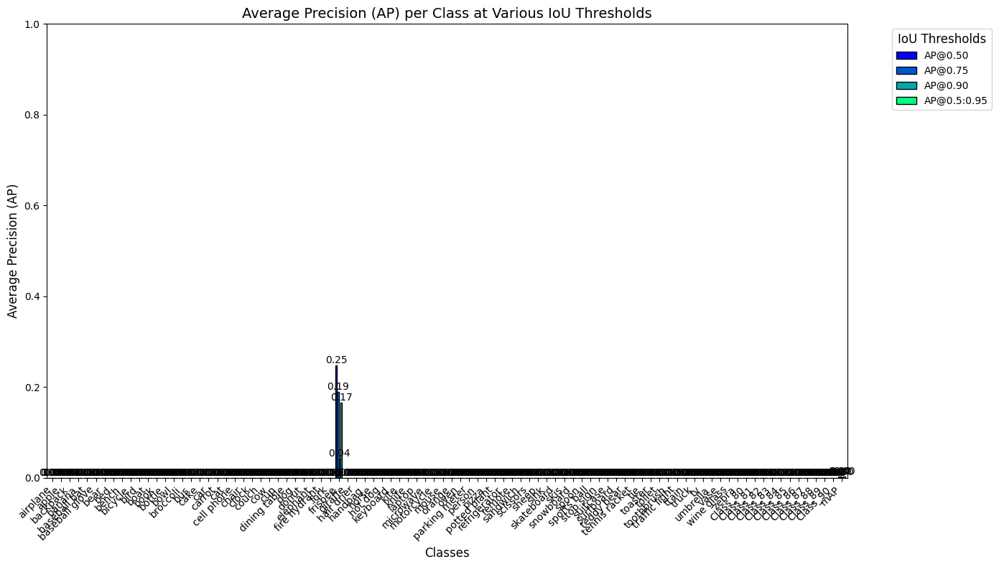

IndexError: too many indices for tensor of dimension 1

In [ ]:
# Load the best model weights
model.load_state_dict(torch.load(f'{SAVE_DIR}/weights/best.pth'))

# Set the model to evaluation mode
model.eval()

# Retrieving the class names
class_names = [cls["name"] for cls in CLASSES]

# Evaluate the model on the test set
evaluate(model, test_data_loader, device, class_names=class_names)

### Model Inference/Testing

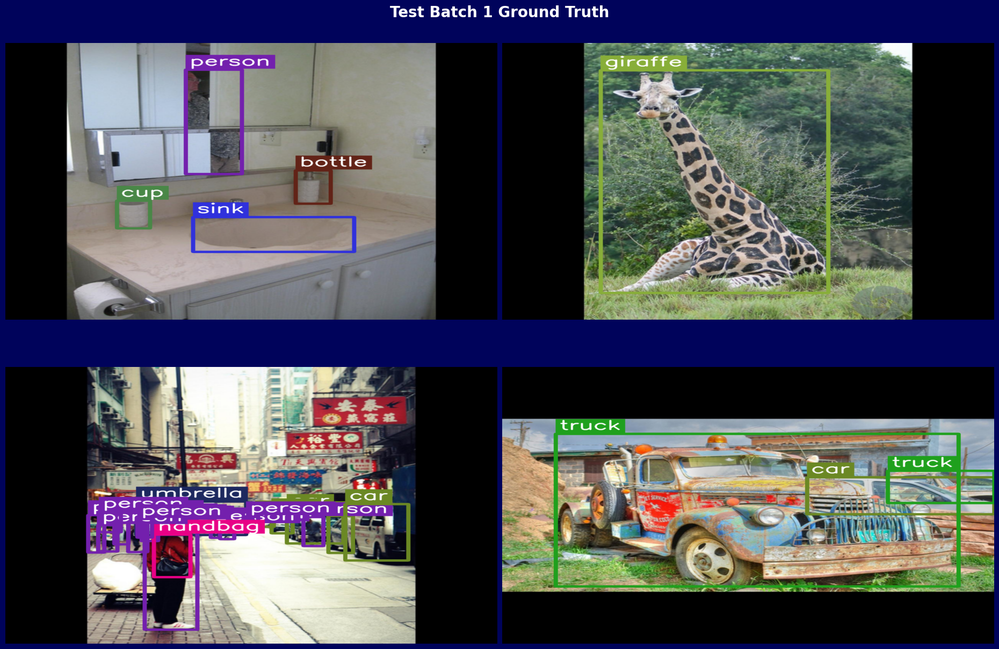

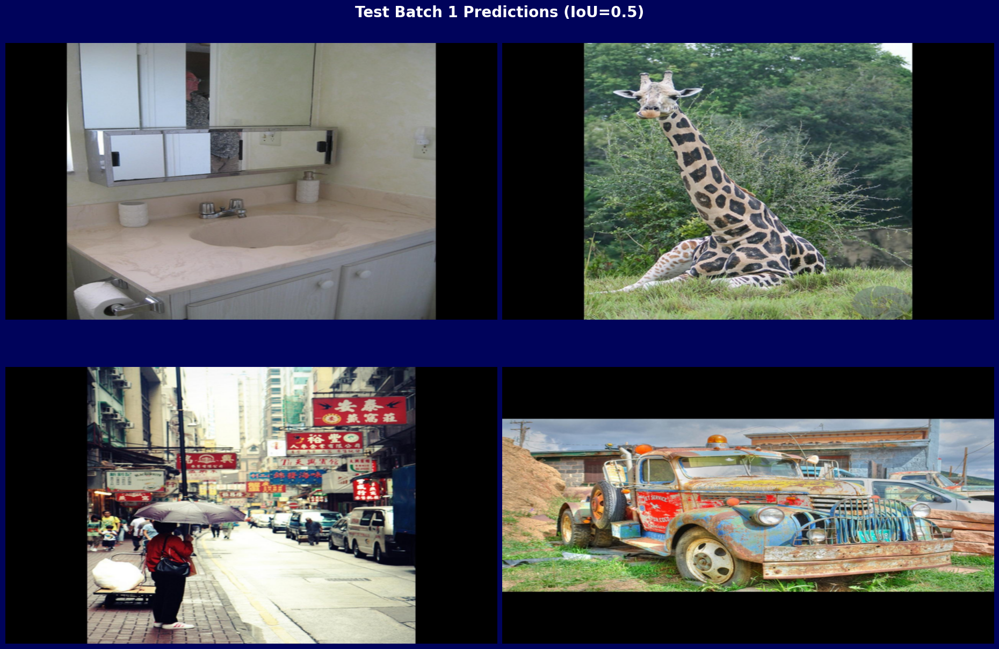

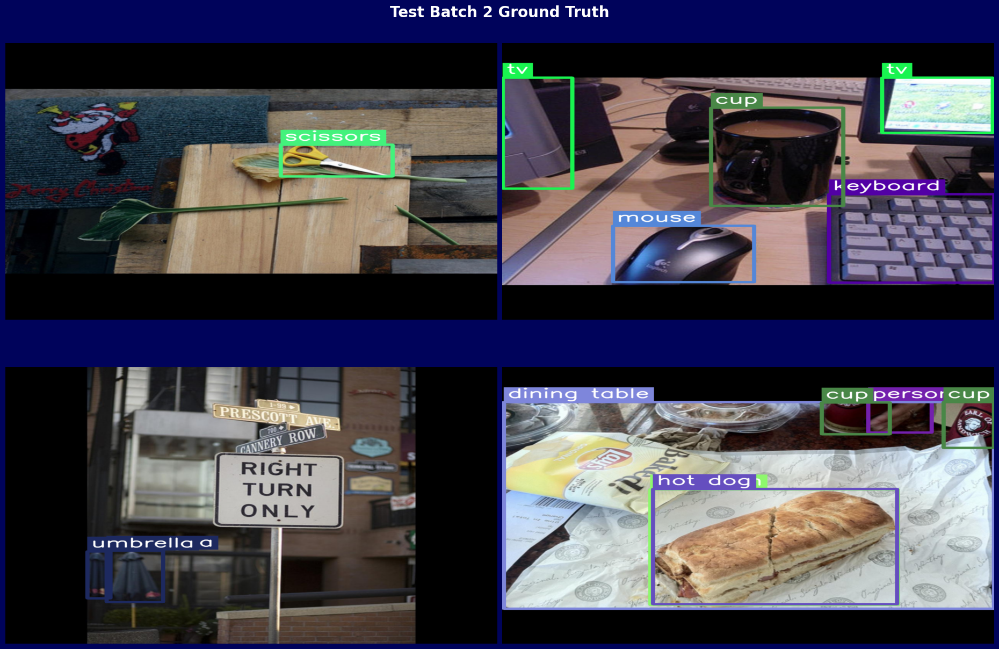

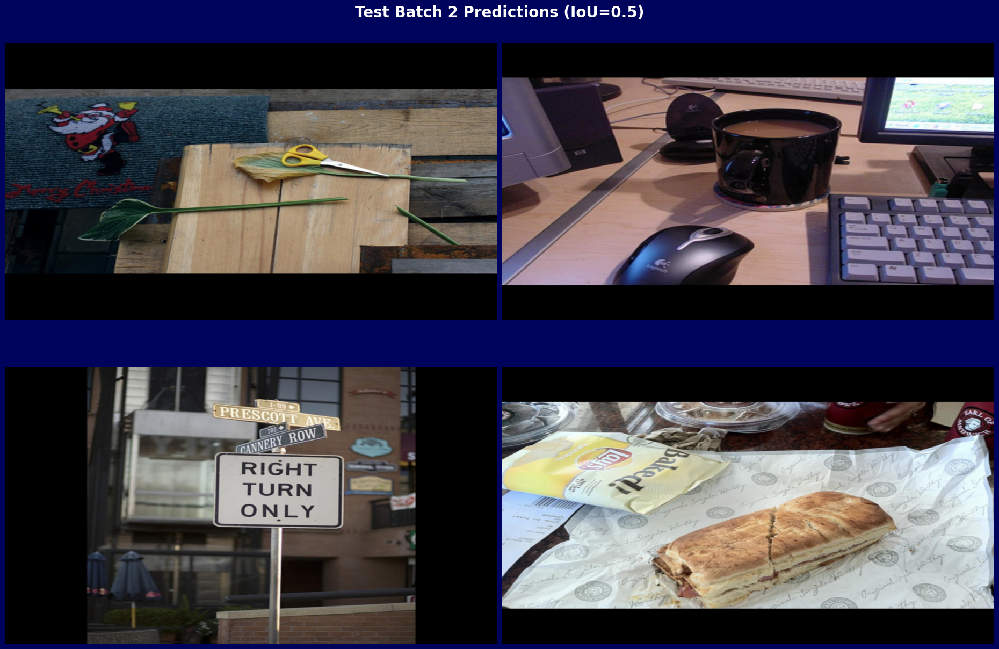

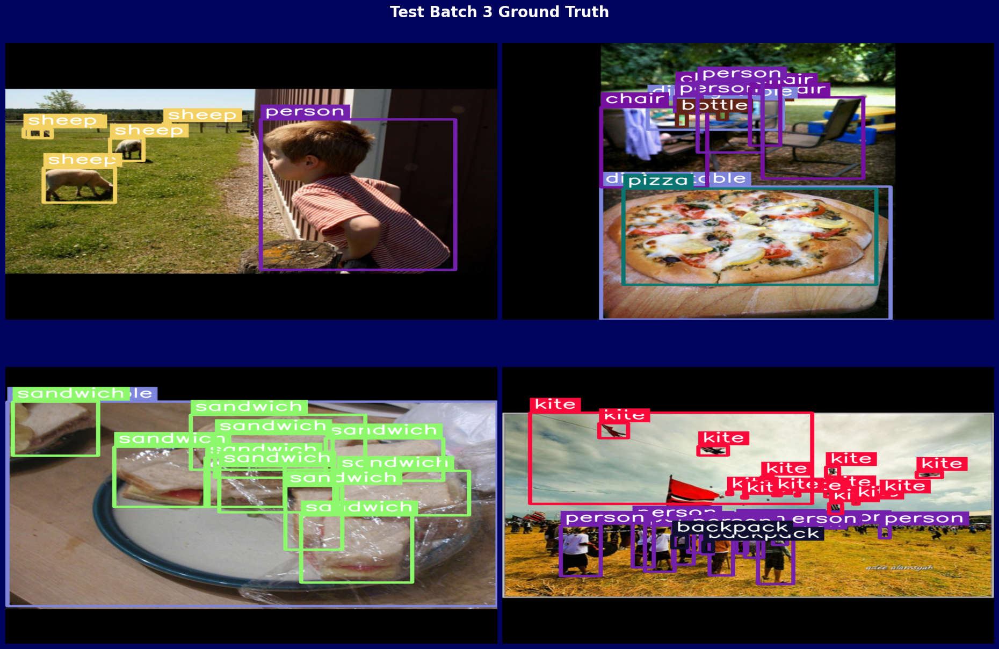

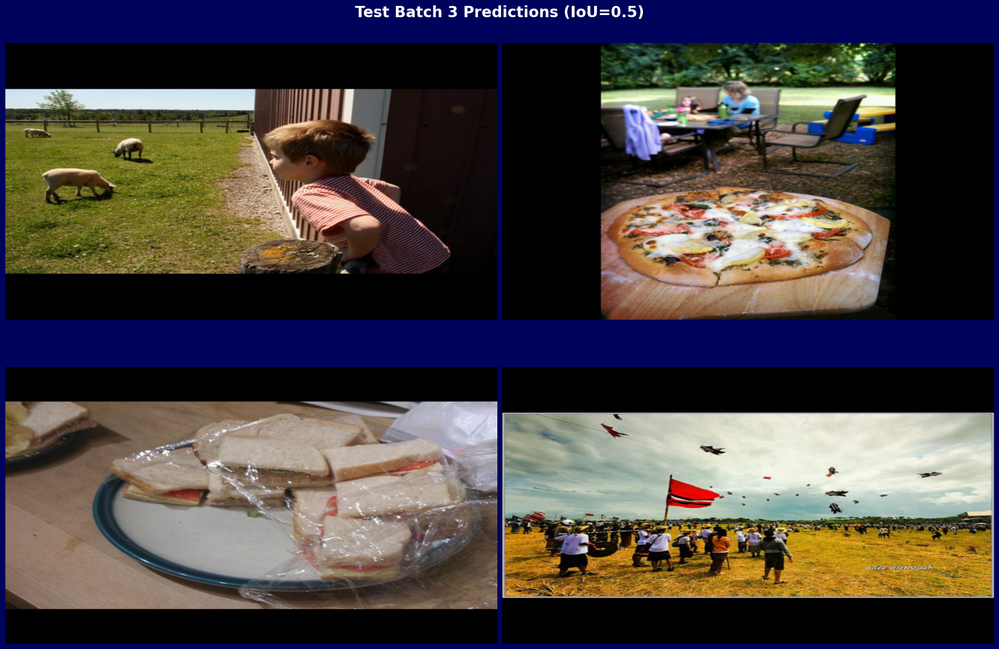

In [ ]:
def plot_batches_as_mosaic(test_data_loader, device, num_batches=3, channel_indices=[0, 1, 2], class_definitions=CLASSES, resize_size=(1920, 1080), iou_threshold=0.5):
    """
    Plots three figures, one for each batch, showing images as a 2x2 grid with bounding boxes and class labels.
    
    Parameters:
    - test_data_loader: DataLoader for the test data.
    - device: The device (CPU or GPU) for computation.
    - num_batches: Number of batches to plot.
    - channel_indices: List of channel indices to extract for visualisation (e.g., [0, 1, 2] for RGB).
    - class_definitions: List of class dictionaries containing id, name, and color.
    - resize_size: Size to resize the images for display.
    """
    class_lookup = {cls["id"]: (cls["name"], tuple(cls["color"])) for cls in class_definitions}

    # Evaluate the model on the test set
    model.eval()

    # Create a single iterator for the data loader
    data_iter = iter(test_data_loader)

    for batch_idx in range(num_batches):
        try:
            # Load a batch of data from the iterator
            images, targets = next(data_iter)
        except StopIteration:
            print("No more batches available in test_data_loader!")
            break

        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Forward pass
        with torch.no_grad():
            outputs = model(images)

        # Filter predictions based on score threshold (e.g., 0.5)
        for i in range(len(outputs)):
            keep = outputs[i]['scores'] >= iou_threshold
            outputs[i] = {k: v[keep] for k, v in outputs[i].items()}

        # Create a 2x2 grid for visualization of ground truth
        num_images = len(images)
        grid_size = math.ceil(np.sqrt(num_images))
        fig, axes = plt.subplots(grid_size, grid_size, figsize=(23, 15))
        axes = axes.flatten()

        for img_idx, (image, target) in enumerate(zip(images, targets)):
            sample_image = image.cpu().numpy()

            # Keep only the specified channels
            selected_channels = [sample_image[i] for i in channel_indices]
            selected_channels = [(channel * 255).astype(np.uint8) for channel in selected_channels]
            sample_image_rgb = np.stack(selected_channels, axis=-1).astype(np.uint8)

            boxes = target['boxes'].cpu().numpy()
            labels = target['labels'].cpu().numpy()
            size = target['size'].cpu().numpy()

            # Resize the image and bounding boxes based on the original size
            original_size_x, original_size_y = size[0]
            resize_ratio_x = original_size_x / IMG_RESIZE[0]
            resize_ratio_y = original_size_y / IMG_RESIZE[1]

            # resizing the bounding boxes
            for box in boxes:
                box[0] *= resize_ratio_x
                box[2] *= resize_ratio_x
                box[1] *= resize_ratio_y
                box[3] *= resize_ratio_y

            sample_image_rgb = cv2.resize(sample_image_rgb, size[0])        

            for i, box in enumerate(boxes):
                x_min, y_min, x_max, y_max = map(int, box)
                class_id = labels[i]
                class_name, color = class_lookup.get(class_id, (f'Class {class_id}', (255, 255, 255)))

                cv2.rectangle(sample_image_rgb, (x_min, y_min), (x_max, y_max), color, 10)

                font_scale = 2
                (text_width, text_height), baseline = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, font_scale, thickness=2)
                padding = 10
                text_width += 2 * padding
                text_height += 2 * padding

                cv2.rectangle(sample_image_rgb, (x_min, y_min - text_height - 5),
                              (x_min + text_width, y_min - 5), color, -1)
                cv2.putText(sample_image_rgb, class_name, (x_min + padding, y_min - padding - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), thickness=4, lineType=cv2.LINE_AA)

            sample_image_rgb = cv2.resize(sample_image_rgb, resize_size)
            axes[img_idx].imshow(sample_image_rgb)
            axes[img_idx].axis('off')

        for ax in axes[num_images:]:
            ax.axis('off')

        fig.suptitle(f"Test Batch {batch_idx + 1} Ground Truth", fontsize=20, weight='bold', color='white', y=0.92)
        plt.tight_layout()
        plt.subplots_adjust(wspace=0.01, hspace=0.01, top=0.9, bottom=0.1, left=0.1, right=0.9)
        fig.patch.set_facecolor('xkcd:dark blue')
        plt.savefig(f'{SAVE_DIR}/test_batch_{batch_idx + 1}_labels.png', bbox_inches='tight', pad_inches=0)
        plt.show()

        # Now plot the predictions
        fig, axes = plt.subplots(grid_size, grid_size, figsize=(23, 15))
        axes = axes.flatten()

        for img_idx, (image, target) in enumerate(zip(images, targets)):
            sample_image = image.cpu().numpy()
            selected_channels = [sample_image[i] for i in channel_indices]
            selected_channels = [(channel * 255).astype(np.uint8) for channel in selected_channels]
            sample_image_rgb = np.stack(selected_channels, axis=-1).astype(np.uint8)

            boxes = outputs[img_idx]['boxes'].cpu().detach().numpy()
            labels = outputs[img_idx]['labels'].cpu().detach().numpy()
            scores = outputs[img_idx]['scores'].cpu().detach().numpy()
            size = target['size'].cpu().numpy()

            # Resize the image and bounding boxes based on the original size
            original_size_x, original_size_y = size[0]
            resize_ratio_x = original_size_x / IMG_RESIZE[0]
            resize_ratio_y = original_size_y / IMG_RESIZE[1]

            # resizing the bounding boxes
            for box in boxes:
                box[0] *= resize_ratio_x
                box[2] *= resize_ratio_x
                box[1] *= resize_ratio_y
                box[3] *= resize_ratio_y

            sample_image_rgb = cv2.resize(sample_image_rgb, size[0])        

            for i, box in enumerate(boxes):
                x_min, y_min, x_max, y_max = map(int, box)
                class_id = labels[i]
                class_name, color = class_lookup.get(class_id, (f'Class {class_id}', (255, 255, 255)))
                class_name = f"{class_name} {scores[i]:.0%}"

                cv2.rectangle(sample_image_rgb, (x_min, y_min), (x_max, y_max), color, 10)

                font_scale = 2
                (text_width, text_height), baseline = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, font_scale, thickness=2)
                padding = 10
                text_width += 2 * padding
                text_height += 2 * padding

                cv2.rectangle(sample_image_rgb, (x_min, y_min - text_height - 5),
                              (x_min + text_width, y_min - 5), color, -1)
                cv2.putText(sample_image_rgb, class_name, (x_min + padding, y_min - padding - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), thickness=4, lineType=cv2.LINE_AA)

            sample_image_rgb = cv2.resize(sample_image_rgb, resize_size)
            axes[img_idx].imshow(sample_image_rgb)
            axes[img_idx].axis('off')

        for ax in axes[num_images:]:
            ax.axis('off')

        fig.suptitle(f"Test Batch {batch_idx + 1} Predictions (IoU={iou_threshold})", fontsize=20, weight='bold', color='white', y=0.92)
        plt.tight_layout()
        plt.subplots_adjust(wspace=0.01, hspace=0.01, top=0.9, bottom=0.1, left=0.1, right=0.9)
        fig.patch.set_facecolor('xkcd:dark blue')
        plt.savefig(f'{SAVE_DIR}/test_batch_{batch_idx + 1}_predictions.png', bbox_inches='tight', pad_inches=0)
        plt.show()

# Example usage
plot_batches_as_mosaic(test_data_loader, device, num_batches=3, channel_indices=[0, 1, 2], class_definitions=CLASSES)
